In [56]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
#!rm -r '/content/PolyU-Real-World-Noisy-Images-Dataset'

In [0]:
import cv2
import itertools
import math
import matplotlib.pyplot as plt
import numpy as np
import os
from skimage.util import random_noise
from skimage import io, transform
from sys import stdout
import random

import torch
import torch.nn as nn
import torch.nn.functional as F
import shutil
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler

from scipy.ndimage.filters import uniform_filter
from scipy.ndimage.measurements import variance

torch.manual_seed(1)

plt.rcParams["figure.figsize"] = (20,10)

**Data Loading**

In [59]:
!git clone "https://github.com/csjunxu/PolyU-Real-World-Noisy-Images-Dataset.git"

fatal: destination path 'PolyU-Real-World-Noisy-Images-Dataset' already exists and is not an empty directory.


In [0]:
class ImagesDataset(Dataset):
    """Images dataset."""

    def __init__(self, root_dir, augment = False, noise=None):
        # Finding the list of all files in the directory
        filenames = []
        for file_base in os.listdir(root_dir):
            filenames.append(file_base)
        self.root_dir = root_dir
        self.image_names = filenames
        self.augment = augment
        self.noise = noise
        print("Noise: " + noise)

    def __len__(self):
        return 800

    def __getitem__(self, idx):

        img_name = os.path.join(self.root_dir, str(idx) + '_target.jpg')
        image = cv2.imread(img_name)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 
        image = cv2.resize(image, (512, 512))
        image = image / 255

        # Noisy image from dataset
        noisy_name = os.path.join(self.root_dir, str(idx) + '_noisy.jpg')
        noisy = cv2.imread(noisy_name)
        noisy = cv2.cvtColor(noisy, cv2.COLOR_BGR2RGB)
        noisy = cv2.resize(noisy, (512, 512))
        noisy = noisy / 255

        if self.noise and self.noise == 'gaussian':
            noisy = gaussian_noise(noisy)
        elif self.noise and self.noise == 'salt_and_pepper':
            noisy = salt_and_pepper(noisy)
        elif self.noise and self.noise == 'salt_and_pepper_color':
            noisy = salt_and_pepper_color(noisy)   
        elif self.noise and self.noise == 'speckle':
            noisy = speckle_noise(noisy)  
        
        image_and_noisy = {'image': image, 'noisy': noisy}
        return image_and_noisy

**Data Augmentation**

In [0]:
def zoom(img, scale):
  original_shape = img.shape
  scaled = cv2.resize(img, None, fx= scale, fy= scale, interpolation= cv2.INTER_LINEAR)

  cropped = scaled[int((original_shape[0]*scale)//2):int(original_shape[0]+(original_shape[0]*scale)//2), int((original_shape[1]*scale)//2):int(original_shape[1]+(original_shape[1]*scale)//2), :]
  return cropped

def sharpen(img):
  kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
  # Normalize
  kernel = (1/kernel.sum()) * kernel
  return cv2.filter2D(img, -1, kernel)

def contrast(img, alpha, beta):
  """
  Edits the contrast curve on the given image
  https://math.stackexchange.com/a/906280/357701
  """
  new_image = cv2.convertScaleAbs(img, alpha=alpha, beta=beta)
  return new_image

def blur(img):
  new_image = cv2.blur(img,(3,3))
  return new_image


**Noise functions**

In [0]:
def gaussian_noise(img, mu=0, sigma=0.5):
    """
    Return an image with pixel intensity in range [0, 1] and add gaussian noise.

    Args:

    img (ndarray) : image matrix to apply gaussian noise to

    Optional args:

    mu: mean with default value of 0
    sigma: standard deviation with default value of 0.5
    """
    gaussian = np.random.normal(mu, sigma, img.shape)
    noisy_img = img + gaussian
    noisy_img = np.clip(noisy_img, 0, 1)
    return noisy_img

In [0]:
def salt_and_pepper(img, density=0.05, salt_ratio=0.5):
    """
    Return an image with salt and pepper noise.

    Args:

    img (numpy.ndarray) : image matrix to apply blur to

    Optional args:

    density (float) : percent of pixels to be affected by noise
    salt_ratio : percent of affected pixels that are salt

    https://stackoverflow.com/questions/22937589/how-to-add-noise-gaussian-salt-and-pepper-etc-to-image-in-python-with-opencv
    """
    (n_rows, n_cols) = img.shape
    num_s_pixels = math.floor(img.size * density * salt_ratio)
    pts_s = [np.random.randint(0, i - 1, int(num_s_pixels)) for i in img.shape]
    img[tuple(pts_s)] = 1

    num_p_pixels = math.floor(img.size * density * (1 - salt_ratio))
    pts_p = [np.random.randint(0, i - 1, int(num_p_pixels)) for i in img.shape]
    img[tuple(pts_p)] = 0

    return img

In [0]:
def salt_and_pepper_color(img, density=0.05):
    """
    Return a colored image with colored salt and pepper noise.

    Args:

    img (numpy.ndarray) : image matrix to apply blur to

    Optional args:

    density (float) : percent of pixels to be affected by noise
    """
    r, g, b = cv2.split(img)

    sp_r = salt_and_pepper(r, density)
    sp_g = salt_and_pepper(g, density)
    sp_b = salt_and_pepper(b, density)
    
    sp_img = cv2.merge((r, g, b))
    return sp_img

In [0]:
def speckle_noise(img):
    if (img.ndim == 3):
        gaussian = np.random.randn(img.shape[0], img.shape[1], img.shape[2])
    else:
        gaussian = np.random.randn(img.shape[0], img.shape[1])
    noisy_img = img + img * gaussian
    noisy_img = np.clip(noisy_img, 0, 1)
    return noisy_img

In [0]:
def lee_filter(img, size):
    img_mean = uniform_filter(img, (size, size))
    img_square_mean = uniform_filter(img ** 2, (size, size))
    img_variance = img_square_mean - img_mean ** 2

    total_variance = variance(img)
    weights = img_variance / (img_variance + total_variance)
    out = img_mean + weights * (img - img_mean)
    return out

def median_filter(image):
    median = cv2.medianBlur(image, 5)
    return median

def gaussian_filter(image):
    gaussian = cv2.GaussianBlur(image, (3, 3), 2)
    return gaussian

def bilateral_filter(image):
    bilateral = cv2.bilateralFilter(image, 9, 75, 75)
    return bilateral

def filter_img(img, type):
    if (type == 'gaussian'):
        return gaussian_filter(img)
    elif (type == 'median'):
        return median_filter(img)
    elif (type == 'bilateral'):
        return bilateral_filter(img)
    elif (type == 'lee'):
        return lee_filter(img, 20) 

**Data copying and augmentation**

In [0]:
#Data augmentation
def choose_quarter(img, quadrant):
  """
  Returns the specified quadrant of the image
  1 2
  3 4
  """

  if quadrant == 1:
    smaller_image = img[:img.shape[0]//2,:img.shape[0]//2, :]
  elif quadrant == 2:
    smaller_image = img[:img.shape[0]//2,img.shape[0]//2:, :]
  elif quadrant == 3:
    smaller_image = img[img.shape[0]//2:,:img.shape[0]//2, :]
  else:
    smaller_image = img[img.shape[0]//2:,img.shape[0]//2:, :]

  return smaller_image
  
filenames = []
image_dir = '/content/PolyU-Real-World-Noisy-Images-Dataset/OriginalImages/'
#find all the filenames in the directory
for file_base in os.listdir(image_dir):
    filenames.append(file_base)
noisy = [name for name in filenames if name.endswith('Real.JPG')]
target = [name.replace('Real.JPG', 'mean.JPG') for name in noisy]

photo_num = 0
for i in range(len(noisy)):
    old_noisy = noisy[i]
    noisy_img = io.imread(image_dir+old_noisy)

    old_target = target[i]
    target_img = io.imread(image_dir+old_target)

    # Split the images up in quadrants 1 to 4
    for j in range(1,5):
        new_name = str(photo_num) + '_noisy.jpg'
        quarter_image = choose_quarter(noisy_img, j)
        cv2.imwrite(image_dir+new_name, quarter_image)

        new_name = str(photo_num) + '_target.jpg'
        quarter_image = choose_quarter(target_img, j)
        cv2.imwrite(image_dir+new_name, quarter_image)

        photo_num += 1
    
#Rename the old files
for old_name in filenames:
    os.remove(image_dir+old_name)

# By this point in the file processing, you can copy the dataset 4 times over for the 4 augmentations
# Loop over all the existing files and make a copy with augmentations
augmented_images_ind = photo_num

for i in range(0, photo_num):
    old_noisy = io.imread(image_dir+str(i)+ '_noisy.jpg')
    old_target = io.imread(image_dir+str(i)+ '_target.jpg')
    
    for augmentation in ['zoom', 'sharpen', 'contrast', 'blur']:
        new_noisy_name = str(augmented_images_ind) + '_noisy.jpg'
        new_target_name = str(augmented_images_ind) + '_target.jpg'
        if augmentation == 'zoom':
            scale = random.uniform(1, 2)
            cv2.imwrite(image_dir+new_noisy_name, zoom(old_noisy, scale))
            cv2.imwrite(image_dir+new_target_name, zoom(old_target, scale))

        elif augmentation == 'sharpen':
            cv2.imwrite(image_dir+new_noisy_name, sharpen(old_noisy))
            cv2.imwrite(image_dir+new_target_name, sharpen(old_target))  

        elif augmentation == 'contrast':
            alpha = random.uniform(0, 2)
            beta = random.uniform(-255, 255)
            cv2.imwrite(image_dir+new_noisy_name, contrast(old_noisy, alpha, beta))
            cv2.imwrite(image_dir+new_target_name, contrast(old_target, alpha, beta)) 

        elif augmentation == 'blur':
            cv2.imwrite(image_dir+new_noisy_name, blur(old_noisy))
            cv2.imwrite(image_dir+new_target_name, blur(old_target)) 
        augmented_images_ind += 1

**Model**

In [0]:
class Config:
    num_channels = 3
    num_features = 64
    num_layers = 5
    kernel_size = 3
    padding = 1

    batch_size = 8
    num_epochs = 50
    lr = 1e-1

In [0]:
class Model(nn.Module):
    """
    Image Denoising using CNN.
    """

    def __init__(self, config):
        super(Model, self).__init__()
        self.config = config

        layers = [
            nn.Conv2d(in_channels=self.config.num_channels,
                      out_channels=self.config.num_features,
                      kernel_size=self.config.kernel_size,
                      padding=self.config.padding,
                      bias=False),
            nn.ReLU(inplace=True)
        ]

        for _ in range(self.config.num_layers - 2):
            layers.append(
                nn.Conv2d(in_channels=self.config.num_features,
                      out_channels=self.config.num_features,
                      kernel_size=self.config.kernel_size,
                      padding=self.config.padding,
                      bias=False)
            )
            layers.append(nn.BatchNorm2d(self.config.num_features))
            layers.append(nn.ReLU(inplace=True))
        
        layers.append(
            nn.Conv2d(in_channels=self.config.num_features,
                      out_channels=self.config.num_channels,
                      kernel_size=self.config.kernel_size,
                      padding=self.config.padding,
                      bias=False)
        )
        self.layers = nn.Sequential(*layers)

        self._init_optimizer()

    def _init_optimizer(self):
        """
        Initialize optimizer of choice here.
        """
        self.optimizer = torch.optim.Adam(self.parameters(), lr=self.config.lr)

    def get_loss(self, input, target):
        """
        """
        return (nn.MSELoss()(input, target)) / (input.data.shape[0] * 2)

    def forward(self, x):
        """
        """
        y = x
        out = self.layers(x)
        return y - out
        
    def fit(self, dataloader, filter_name='gaussian'):
        """
        """
        #GRAPHING
        ml_psnr = []
        ml_training_loss = []
        epochs = [i for i in range(self.config.num_epochs)]

        for epoch in range(self.config.num_epochs):
            print('Epoch {}/{}'.format(epoch + 1, self.config.num_epochs))
            self.train()
            total_loss = 0
            total_ml_accuracy = 0
            total_non_ml_accuracy = 0
            for _, mapping in enumerate(dataloader):
                input = mapping['noisy'].permute(0, 3, 1, 2).float()
                target = mapping['image'].permute(0, 3, 1, 2).float()

                pred = self(input)
                self.optimizer.zero_grad()
                loss = self.get_loss(pred, target)
                loss.backward()
                self.optimizer.step()
                total_loss += loss.item()

                batch_psnr = 0
                for i in range(len(target)):
                    img1 = target[i].permute(1, 2, 0).detach().squeeze().cpu().numpy()
                    img2 = pred[i].clamp(0, 1).permute(1, 2, 0).detach().squeeze().cpu().numpy()
                    batch_psnr += PSNR(img1, img2)
                total_ml_accuracy += batch_psnr / len(target)

                batch_psnr = 0
                for i in range(len(target)):
                    img1 = target[i].permute(1, 2, 0).detach().squeeze().cpu().numpy()
                    img2 = filter_img(input[0].permute(1, 2, 0).detach().squeeze().cpu().numpy(),
                                      filter_name)
                    batch_psnr += PSNR(img1, img2)
                total_non_ml_accuracy += batch_psnr / len(target)

            print("training loss: {}".format(total_loss / len(dataloader)))
            print ('ml psnr: {}'.format(total_ml_accuracy / len(dataloader)))
            print (filter_name + ' non-ml psnr: {}'.format(total_non_ml_accuracy / len(dataloader)))

            #GRAPHING
            ml_psnr.append(total_ml_accuracy / len(dataloader))
            ml_training_loss.append(total_loss / len(dataloader))
            
            fig, ax = plt.subplots(1, 3)
            fig.subplots_adjust(hspace=0, wspace=0)

            ax[0].imshow(input[0].permute(1, 2, 0).detach().squeeze().cpu().numpy())
            ax[0].set_yticks([])
            ax[0].set_xticks([])

            ax[1].imshow(target[0].permute(1, 2, 0).detach().squeeze().cpu().numpy())
            ax[1].set_yticks([])
            ax[1].set_xticks([])

            ax[2].imshow(pred[0].clamp(0, 1).permute(1, 2, 0).detach().squeeze().cpu().numpy())
            ax[2].set_yticks([])
            ax[2].set_xticks([])

            plt.show()

            path_to_save = '/content/drive/My Drive/CSC420/salt_and_pepper_median_'+str(epoch)+'_output.jpg'
            fig.savefig(path_to_save)

        #GRAPHING
        #plot and save the graph 
        plt.plot(epochs, ml_training_loss, label='Training loss')
        plt.xlabel('Epochs')
        plt.ylabel('Training Loss')
        plt.title('Training loss on Gaussian Noise over Epochs')
        plt.legend(loc='upper right')
        plt.show()
        plt.savefig('/content/drive/My Drive/CSC420/gaussian_gaussian_training_loss_plot.png')
        plt.clf()

        plt.plot(epochs, ml_psnr, label='PSNR')
        plt.xlabel('Epochs')
        plt.ylabel('PSNR')
        plt.title('PSNR on Gaussian Noise')
        plt.legend(loc='upper right')
        plt.show()
        plt.savefig('/content/drive/My Drive/CSC420/gaussian_gaussian_psnr_plot.png')
        plt.clf()

    def evaluate(self, dataloader, filter_name='gaussian'):
        """
        """
        self.eval()
        with torch.no_grad():
            total_ml_accuracy = 0
            total_non_ml_accuracy = 0
            for _, mapping in enumerate(dataloader):
                input = mapping['noisy'].permute(0, 3, 1, 2).float()
                target = mapping['image'].permute(0, 3, 1, 2).float()
                pred = self(input)

                batch_psnr = 0
                for i in range(len(target)):
                    img1 = target[i].permute(1, 2, 0).detach().squeeze().cpu().numpy()
                    img2 = pred[i].clamp(0, 1).permute(1, 2, 0).detach().squeeze().cpu().numpy()
                    batch_psnr += PSNR(img1, img2)
                total_ml_accuracy += batch_psnr / len(target)

                batch_psnr = 0
                for i in range(len(target)):
                    img1 = target[i].permute(1, 2, 0).detach().squeeze().cpu().numpy()
                    img2 = filter_img(input[0].permute(1, 2, 0).detach().squeeze().cpu().numpy(),
                                      filter_name)
                    batch_psnr += PSNR(img1, img2)
                total_non_ml_accuracy += batch_psnr / len(target)

            print ('ml psnr: {}'.format(total_ml_accuracy / len(dataloader)))
            print ('non-ml psnr: {}'.format(total_non_ml_accuracy / len(dataloader)))
            
            fig, ax = plt.subplots(1, 3)
            fig.subplots_adjust(hspace=0, wspace=0)

            ax[0].imshow(input[0].permute(1, 2, 0).detach().squeeze().cpu().numpy())
            ax[0].set_yticks([])
            ax[0].set_xticks([])

            ax[1].imshow(target[0].permute(1, 2, 0).detach().squeeze().cpu().numpy())
            ax[1].set_yticks([])
            ax[1].set_xticks([])

            ax[2].imshow(pred[0].clamp(0, 1).permute(1, 2, 0).detach().squeeze().cpu().numpy())
            ax[2].set_yticks([])
            ax[2].set_xticks([])

            plt.show()

**Main**

In [0]:
def main(root_dir,
         num_epochs=50,
         num_layers=17,
         num_channels=3,
         batch_size=1,
         lr=1e-3,
         augment=False,
         save=False,
         noise='gaussian',
         filter='gaussian'):
  
    if torch.cuda.is_available():
        torch.set_default_tensor_type(torch.cuda.FloatTensor)
        print('Running on GPU: {}.'.format(torch.cuda.get_device_name()))
    else:
        print('Running on CPU.')

    config = Config()
    config.num_epochs = num_epochs
    config.num_layers = num_layers
    config.num_channels = num_channels
    config.batch_size = batch_size
    config.lr = lr

    training_indices = np.random.choice(800, 200, replace=False)
    unchosen_indices = np.setdiff1d(np.array([i for i in range(800)]), training_indices)
    testing_indices = np.random.choice(unchosen_indices, 50, replace=False)

    images_dataset = ImagesDataset(root_dir=root_dir, augment=augment, noise=noise)
    dataloader = torch.utils.data.DataLoader(images_dataset, shuffle=False, sampler=SubsetRandomSampler(training_indices),
                                             batch_size=config.batch_size)
    
    model = Model(config)
    model.fit(dataloader, filter_name=filter)
    torch.save(model.state_dict(), '/content/drive/My Drive/CSC420/model.pth')

    testloader = torch.utils.data.DataLoader(images_dataset, shuffle=False, sampler=SubsetRandomSampler(testing_indices),
                                          batch_size=config.batch_size)
    model.evaluate(testloader, filter_name=filter)

**Evaluation**

In [0]:
def PSNR(image1, image2):
    """
    Calculates the signal-to-noise ratio between images 1 and 2

    image1 and image2 must be the same shape
    https://en.wikipedia.org/wiki/Peak_signal-to-noise_ratio
    """
    squared_diff = (image1 - image2)**2
    differences_summed = np.sum(squared_diff)

    # Normalize over the number of entries
    # The result is a number that represents how different each pixel is on average
    MSE = differences_summed / image1.size

    # We should not compare the image with itself
    if MSE == 0:
      return "Same image provided"

    max_fluctuation = 255
    return 10 * np.log10(max_fluctuation**2 / MSE)

Filters

Running on GPU: Tesla P100-PCIE-16GB.
Noise: gaussian
Epoch 1/50
training loss: 0.040876150643453
ml psnr: 59.692242462304975
gaussian non-ml psnr: 64.12174868407989


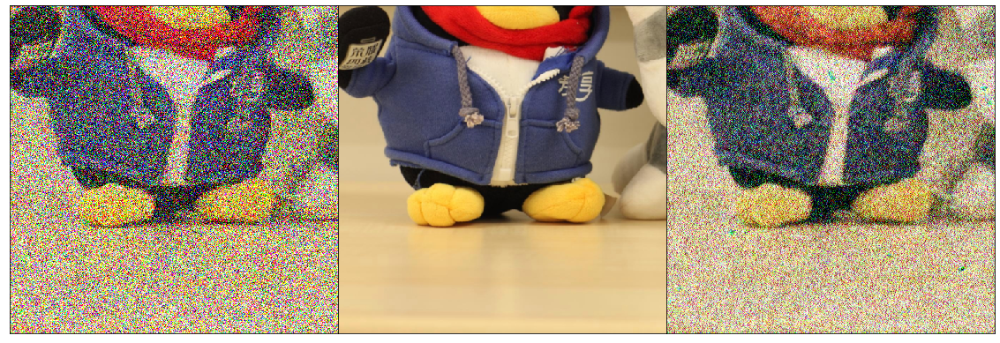

Epoch 2/50
training loss: 0.02327716243918985
ml psnr: 61.870965962713115
gaussian non-ml psnr: 64.12214502020238


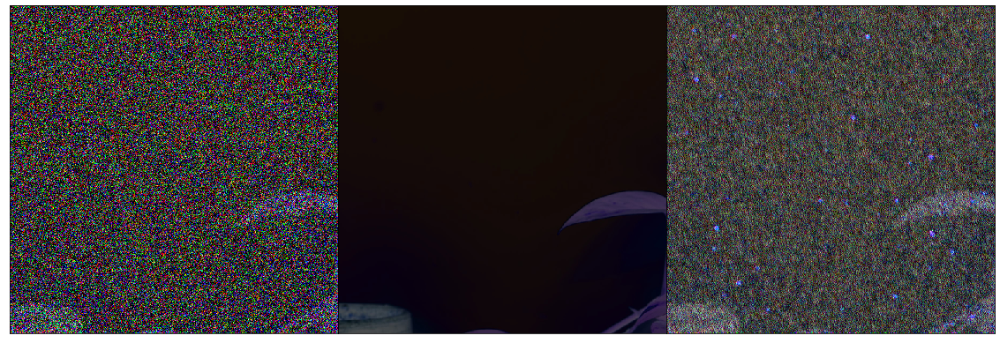

Epoch 3/50
training loss: 0.01156279918504879
ml psnr: 64.99211995309022
gaussian non-ml psnr: 64.11940281342602


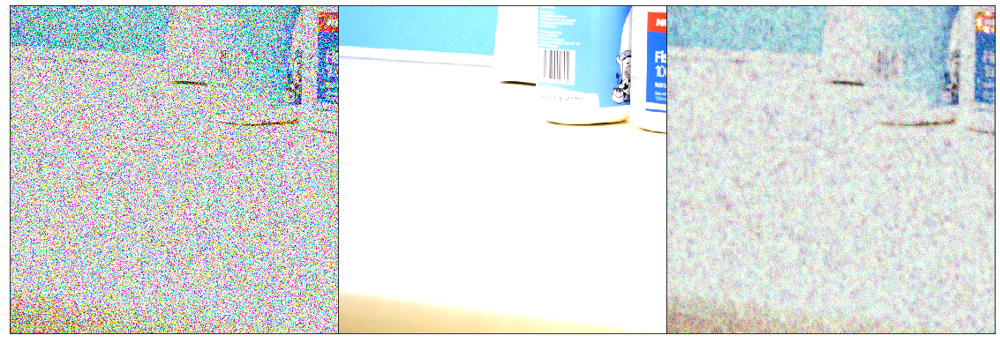

Epoch 4/50
training loss: 0.006955690593458712
ml psnr: 67.11841075453107
gaussian non-ml psnr: 64.12309863277363


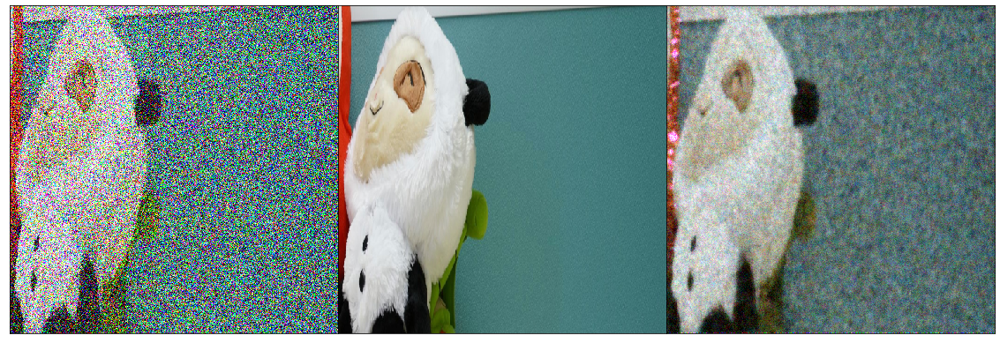

Epoch 5/50
training loss: 0.00563064786256291
ml psnr: 68.08727960054227
gaussian non-ml psnr: 64.12081559176094


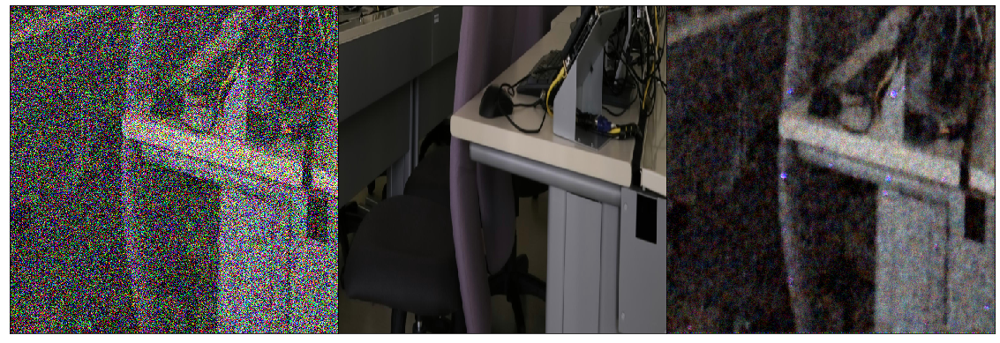

Epoch 6/50
training loss: 0.004645682029658929
ml psnr: 68.86486599410793
gaussian non-ml psnr: 64.12285138059748


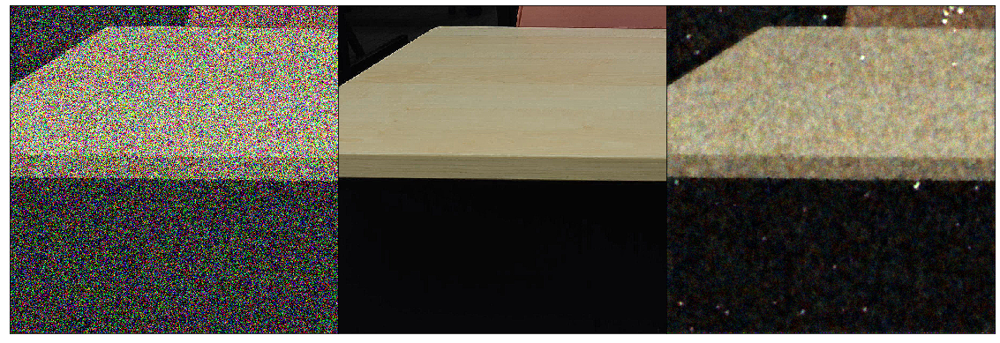

Epoch 7/50
training loss: 0.004211235147668049
ml psnr: 69.35302871869271
gaussian non-ml psnr: 64.1216648171126


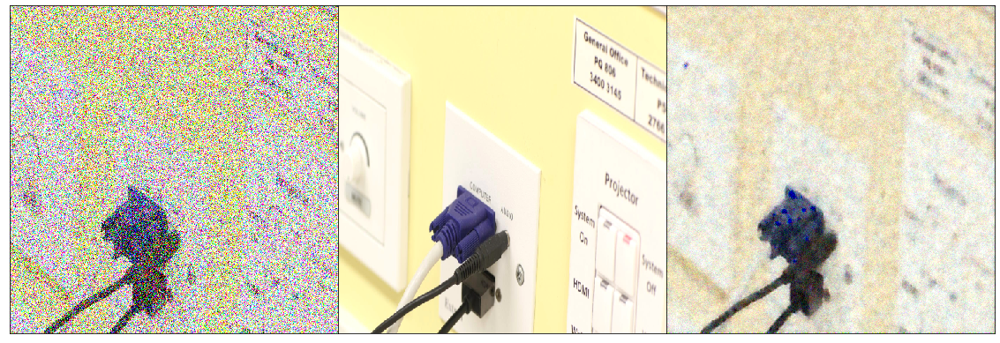

Epoch 8/50
training loss: 0.004108631654526107
ml psnr: 69.48833328444555
gaussian non-ml psnr: 64.12070741509532


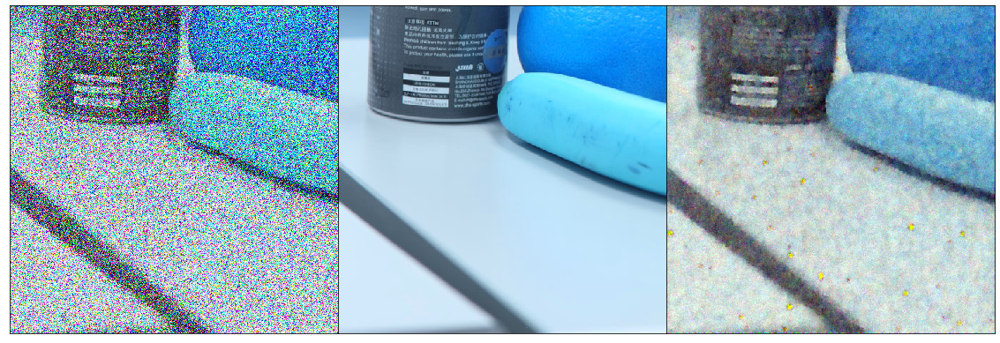

Epoch 9/50
training loss: 0.0038795399450464174
ml psnr: 69.74927199633392
gaussian non-ml psnr: 64.12091340261308


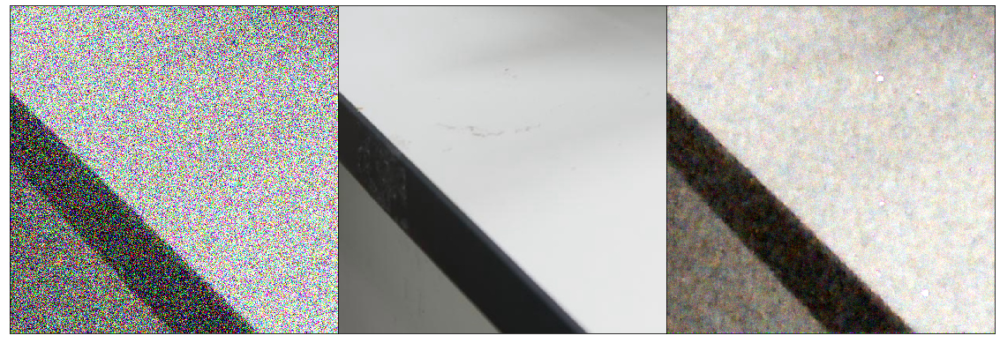

Epoch 10/50
training loss: 0.003726455018622801
ml psnr: 69.96387890983311
gaussian non-ml psnr: 64.12166552794804


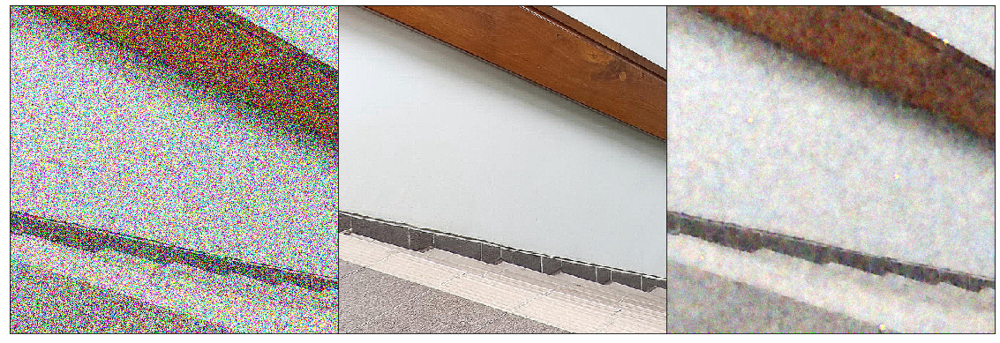

Epoch 11/50
training loss: 0.0034965586999896915
ml psnr: 70.28216921030305
gaussian non-ml psnr: 64.12296699636255


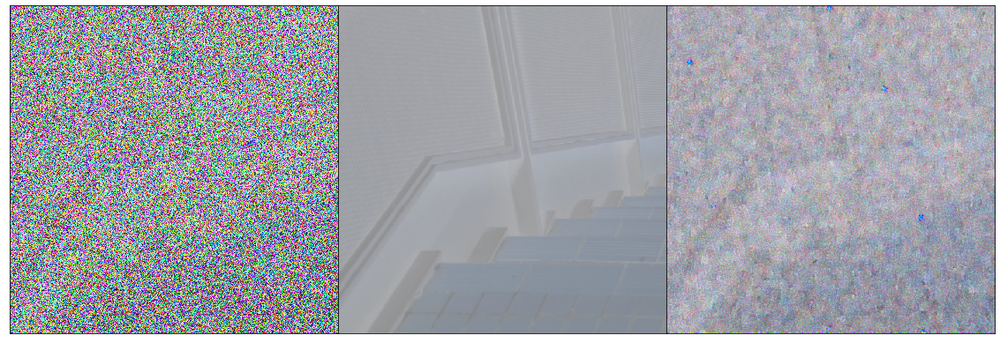

Epoch 12/50
training loss: 0.0035714716574875636
ml psnr: 70.27189384291282
gaussian non-ml psnr: 64.12100817638898


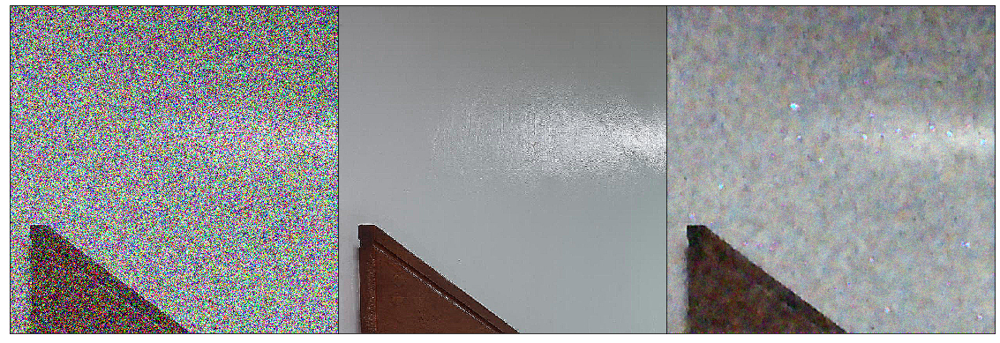

Epoch 13/50
training loss: 0.003410487133078277
ml psnr: 70.39876318807579
gaussian non-ml psnr: 64.12281630525476


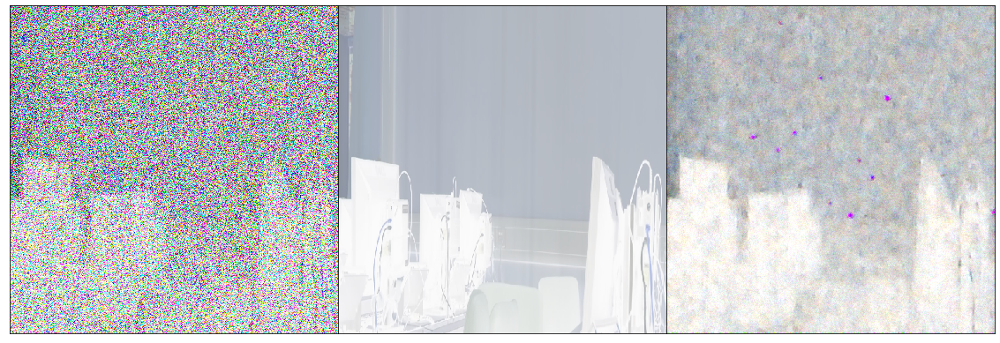

Epoch 14/50
training loss: 0.0033548324910225346
ml psnr: 70.5354073548977
gaussian non-ml psnr: 64.12148483852974


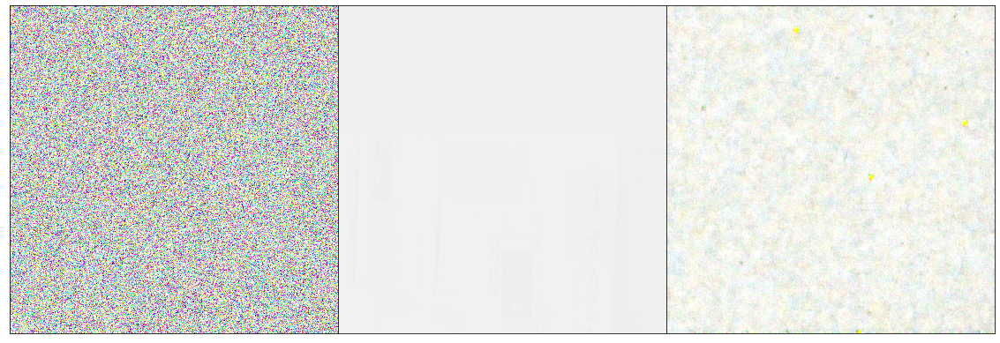

Epoch 15/50
training loss: 0.0033061197528149932
ml psnr: 70.58842055288613
gaussian non-ml psnr: 64.11940833111102


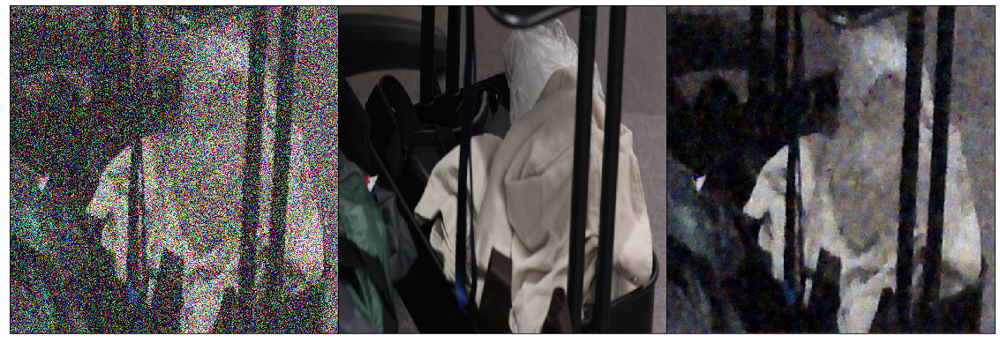

Epoch 16/50
training loss: 0.003217370880302042
ml psnr: 70.76651959622835
gaussian non-ml psnr: 64.12151180800069


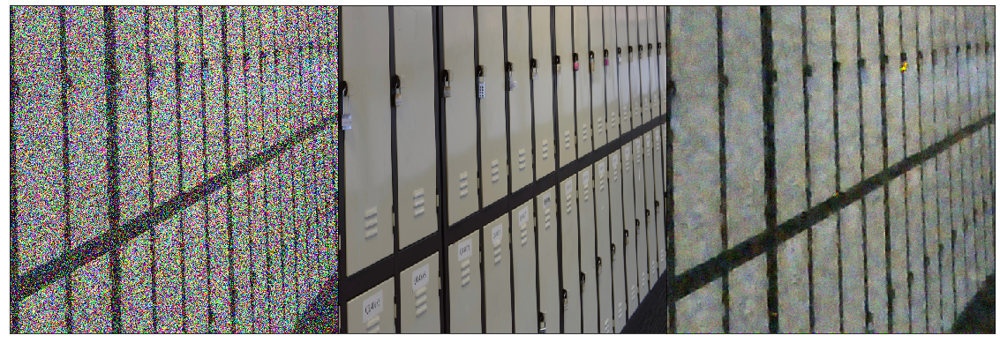

Epoch 17/50
training loss: 0.003064104316290468
ml psnr: 70.9010461160431
gaussian non-ml psnr: 64.12133855068687


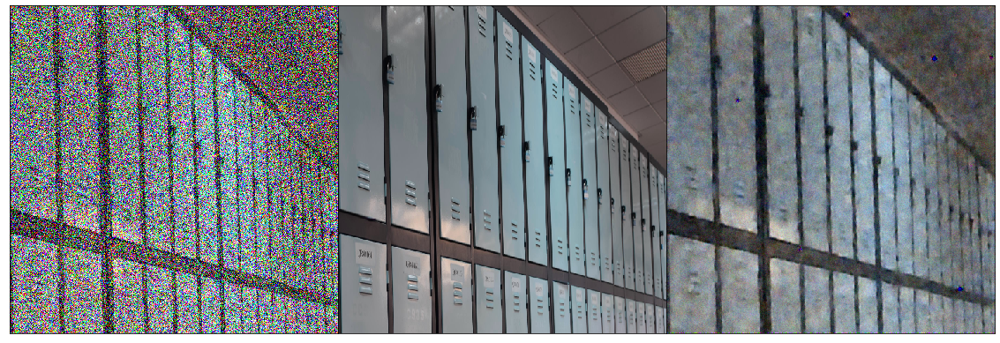

Epoch 18/50
training loss: 0.0031333760841516776
ml psnr: 70.85456799906731
gaussian non-ml psnr: 64.12170947862971


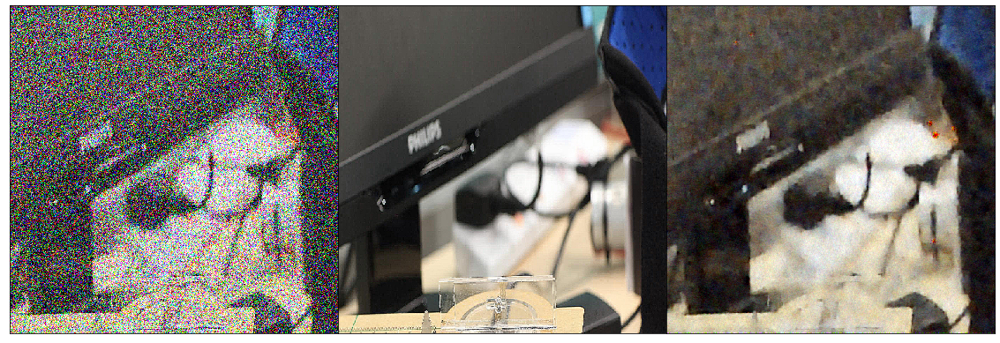

Epoch 19/50
training loss: 0.003939572516828776
ml psnr: 69.96371575986595
gaussian non-ml psnr: 64.12226260218847


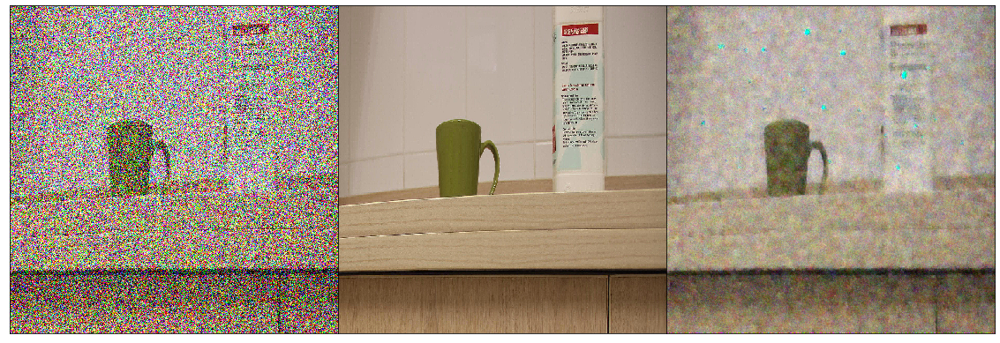

Epoch 20/50
training loss: 0.0032417102134786545
ml psnr: 70.65767553103379
gaussian non-ml psnr: 64.11969091500322


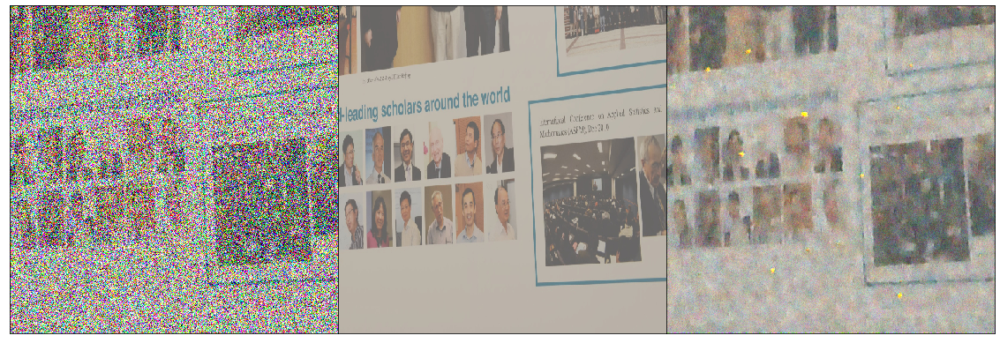

Epoch 21/50


KeyboardInterrupt: ignored

In [72]:
if __name__ == '__main__':
    main('/content/PolyU-Real-World-Noisy-Images-Dataset/OriginalImages/', batch_size=1)